# SMART WATER ANALYTICS - TEAM 4 INTERNS - EXPLORE AI

##### **A PROJECT ON WATER AVAILABILITY MANAGEMENT**

### Team Members

#### Viwe Mqaqa                             | South Africa | viwe@explore-datascience.net | Supervisor

##### Christian Divinefavour           | Nigeria | contact.christiandivinefavour@gmail.com | Author of this Notebook
##### Oreoluwa Onyekachi Olaiya  | Nigeria | olaiyaoreoluwa3@gmail.com
##### Gabriel Asiegbu                      | Nigeria | gwap2@live.com
##### Titus Olang'                             | Kenya  | tityewanjohi@gmail.com
##### Michael Kanu                          | Nigeria | michaelkanu01@yahoo.com
##### Michael Omosebi                    | Nigeria | omosebimichael@live.com      

## Project Overview

The Acea Group is one of the leading Italian multiutility operators. Listed on the Italian Stock Exchange since 1999, the company manages and develops water and electricity networks and environmental services. Acea is the foremost Italian operator in the water services sector supplying 9 million inhabitants in Lazio, Tuscany, Umbria, Molise, Campania.

This project focuses on the water sector to help Acea Group preserve precious waterbodies. As it is easy to imagine, a water supply company struggles with the need to forecast the water level in a waterbody (water spring, lake, river, or aquifer) to handle daily consumption. During fall and winter waterbodies are refilled, but during spring and summer they start to drain. To help preserve the health of these waterbodies it is important to predict the most efficient water availability, in terms of level and water flow for each day of the year.


#### Kaggle Link: https://www.kaggle.com/competitions/acea-water-prediction
#### GitHub Repo: https://github.com/Christian-Divinefavour/smart-water-analytics-explore_ai_team4



### *** This notebooks takes into account EDA and Modelling of the Auser waterbody of Aquifer category.

## Data Overview

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
aquifers = pd.read_csv('Aquifer_Auser.csv')
#rivers = pd.read_csv('River_Arno.csv')
#lakes = pd.read_csv('Lake_Bilancino.csv')
#spring = pd.read_csv('Water_Spring_Amiata.csv')

desc = pd.read_excel('datasets_description.xlsx')
pd.set_option('display.max_rows', desc.shape[0]+1)
pd.options.display.max_colwidth = 500

desc

,Database,Description,Output
0,Aquifer_Auser,"Information about the Auser aquifer. This water body consists of two subsystems, that we call NORH and SOUTH, where the former partly influences the behaviour of the latter.\nThe levels of the NORTH sector are represented by the values of the SAL, PAG, CoS and DIEC wells, while the levels of the SOUTH sector by the LT2 well.","Depth_to_Groundwater_SAL, Depth_to_Groundwater_COS, Depth_to_Groundwater_LT2"
1,Water_Spring_Amiata,"Information about the Amiata aquifer. This aquifer is accessed through the Ermicciolo, Arbure, Bugnano and Galleria Alta springs. \nThe levels and volumes of the four springs are influenced by the parameters: pluviometry, sub-gradation, hydrometry, temperatures and drainage volumes.","Flow_Rate_Bugnano, Flow_Rate_Arbure,\n Flow_Rate_Ermicciolo, Flow_Rate_Galleria_Alta"
2,Aquifer_Petrignano,Information about Petrignano aquifer. \nIt is fed by three underground aquifers separated by low permeability septa; the water table can be considered groundwater and is also fed by the Chiascio river.,"Depth_to_Groundwater_P24,\n Depth_to_Groundwater_P25"
3,Aquifer_Doganella,Information about Doganella aquifer. The Doganella well field is fed by two underground aquifers: \nthe upper stratum is a water table with a thickness of about 30m while the lower one is a semi-confined artesian aquifer with a thickness of 50m.,"Depth_to_Groundwater_Pozzo_1, Depth_to_Groundwater_Pozzo_2, Depth_to_Groundwater_Pozzo_3, Depth_to_Groundwater_Pozzo_4, Depth_to_Groundwater_Pozzo_5, Depth_to_Groundwater_Pozzo_6,\nDepth_to_Groundwater_Pozzo_7, Depth_to_Groundwater_Pozzo_8, Depth_to_Groundwater_Pozzo_9"
4,Aquifer_Luco,"Information about Luco aquifer. It is an underground aquifer not fed by rivers or lakes but fed by meteoric infiltration\n and it is accessed through wells called Pozzo_1, Pozzo_3 and Pozzo_4.",Depth_to_Groundwater_Podere_Casetta
5,River_Arno,"Information about Arno river. The Arno is the second largest river in peninsular Italy and the main waterway in Tuscany and it has a relatively torrential regime, \ndue to the nature of the surrounding soils (marl and impermeable clays)",Hydrometry_Nave_di_Rosano
6,Lake_Bilancino,"Information about Bilancino Lake. It is an artificial lake in Mugello, in the province of Florence. \n It has a maximum depth of thirty-one metres and a surface area of 5 square kilometres.","Lake_Level, \nFlow_Rate"
7,Water_Spring_Madonna_di_Canneto,Information about Madonna di Canneto water spring. The Madonna di Canneto spring is situated at an altitude of 1010m above sea level in the Canneto valley. \nIt does not consist of an aquifer and its source is supplied by the water catchment area of the river Melfa,Flow_Rate
8,Water_Spring_Lupa,Information about Lupa water spring. It is located in the Arrone area and is used for drinking use.,Flow_Rate


### About the Auser River

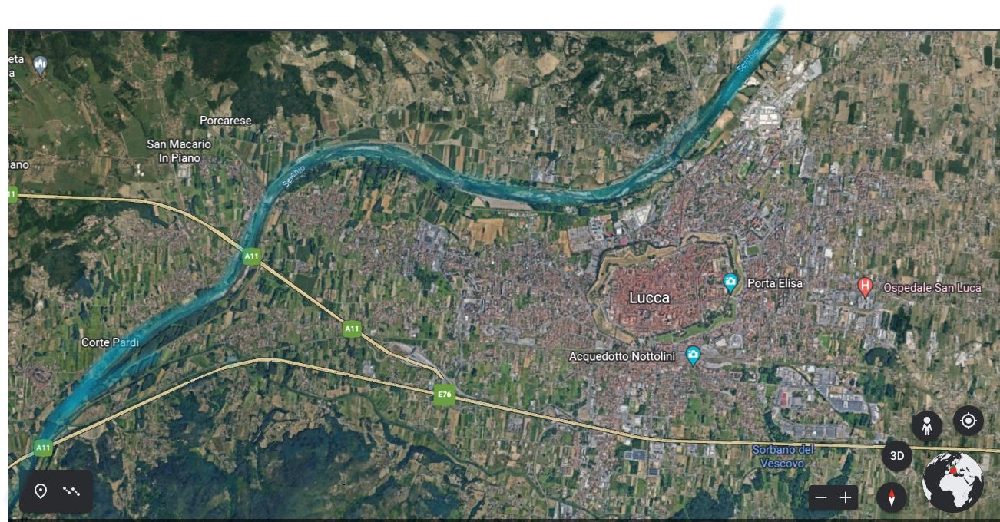

**An aquifer** is an underground layer of water-bearing permeable rock, rock fractures or unconsolidated materials (gravel, sand, or silt).

**River Auser** is recorded as the third longest river in Italy in the region of Tucsany. 

Lucca is one of the major cities in the region and this will be used as our case study. The surrounding cities of the river, including Lucca, are of plain toporgraphy. They are majorly sites for tourists attractions and have quite a number of hotels in the area. There are no major industires or factories in the region too, hence less sources for green house depletion. There are farms and farm houses located in the area too which could aid precipitation and regulate environmental temperature with more oxygen released, than carbon. Residents, farmers, and hotels will be the major utilizers of water in this region.


**Features:**

- Rainfall (mm)
- Temperature (°C)
- Volume (m3)
- Hydrometry (m3)
- Date (yyyy-mm-dd)

(m from the ground floor)

**Target:**

- Depth to Groundwater (m from the ground floor)



### Aquifers

In [3]:
pd.set_option('display.max_rows', aquifers.shape[0]+1)
aquifers.T

,0,1,2,3,4,5,6,7,8,9,...,8144,8145,8146,8147,8148,8149,8150,8151,8152,8153
Date,05/03/1998,06/03/1998,07/03/1998,08/03/1998,09/03/1998,10/03/1998,11/03/1998,12/03/1998,13/03/1998,14/03/1998,...,21/06/2020,22/06/2020,23/06/2020,24/06/2020,25/06/2020,26/06/2020,27/06/2020,28/06/2020,29/06/2020,30/06/2020
Rainfall_Gallicano,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Rainfall_Pontetetto,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Rainfall_Monte_Serra,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Rainfall_Orentano,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Rainfall_Borgo_a_Mozzano,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Rainfall_Piaggione,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Rainfall_Calavorno,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Rainfall_Croce_Arcana,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Rainfall_Tereglio_Coreglia_Antelminelli,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Missing values

In [4]:
print("============")
print("Aquifers: ")
print(aquifers.shape)
print("============")
print(str(aquifers.isnull().sum()))
print("============")

Aquifers: 
(8154, 27)
Date                                          0
Rainfall_Gallicano                         2859
Rainfall_Pontetetto                        2859
Rainfall_Monte_Serra                       2865
Rainfall_Orentano                          2859
Rainfall_Borgo_a_Mozzano                   2859
Rainfall_Piaggione                         3224
Rainfall_Calavorno                         2859
Rainfall_Croce_Arcana                      2859
Rainfall_Tereglio_Coreglia_Antelminelli    2859
Rainfall_Fabbriche_di_Vallico              2859
Depth_to_Groundwater_LT2                   3352
Depth_to_Groundwater_SAL                   3609
Depth_to_Groundwater_PAG                   4347
Depth_to_Groundwater_CoS                   3839
Depth_to_Groundwater_DIEC                  4884
Temperature_Orentano                          0
Temperature_Monte_Serra                       0
Temperature_Ponte_a_Moriano                   0
Temperature_Lucca_Orto_Botanico               0
Volume_POL        

In [5]:
aquifers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8154 entries, 0 to 8153
Data columns (total 27 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Date                                     8154 non-null   object 
 1   Rainfall_Gallicano                       5295 non-null   float64
 2   Rainfall_Pontetetto                      5295 non-null   float64
 3   Rainfall_Monte_Serra                     5289 non-null   float64
 4   Rainfall_Orentano                        5295 non-null   float64
 5   Rainfall_Borgo_a_Mozzano                 5295 non-null   float64
 6   Rainfall_Piaggione                       4930 non-null   float64
 7   Rainfall_Calavorno                       5295 non-null   float64
 8   Rainfall_Croce_Arcana                    5295 non-null   float64
 9   Rainfall_Tereglio_Coreglia_Antelminelli  5295 non-null   float64
 10  Rainfall_Fabbriche_di_Vallico            5295 no

In [6]:
aquifers.Date = pd.to_datetime(aquifers.Date, format='%d/%m/%Y')
aquifers['Year']= aquifers['Date'].dt.year
aquifers['Month']=aquifers['Date'].dt.month
aquifers['Day']=aquifers['Date'].dt.day
aquifers['Day_of_Week'] = aquifers['Date'].dt.dayofweek
aquifers['Week_of_Year'] = aquifers['Date'].dt.weekofyear
aquifers['Day_of_Year'] = aquifers['Date'].dt.dayofyear
aquifers.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  


,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day,Day_of_Week,Week_of_Year,Day_of_Year
0,1998-03-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1998,3,5,3,10,64
1,1998-03-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1998,3,6,4,10,65
2,1998-03-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1998,3,7,5,10,66
3,1998-03-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1998,3,8,6,10,67
4,1998-03-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1998,3,9,0,11,68


In [7]:
aquifers.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day,Day_of_Week,Week_of_Year,Day_of_Year
0,1998-03-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1998,3,5,3,10,64
1,1998-03-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1998,3,6,4,10,65
2,1998-03-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1998,3,7,5,10,66
3,1998-03-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1998,3,8,6,10,67
4,1998-03-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1998,3,9,0,11,68


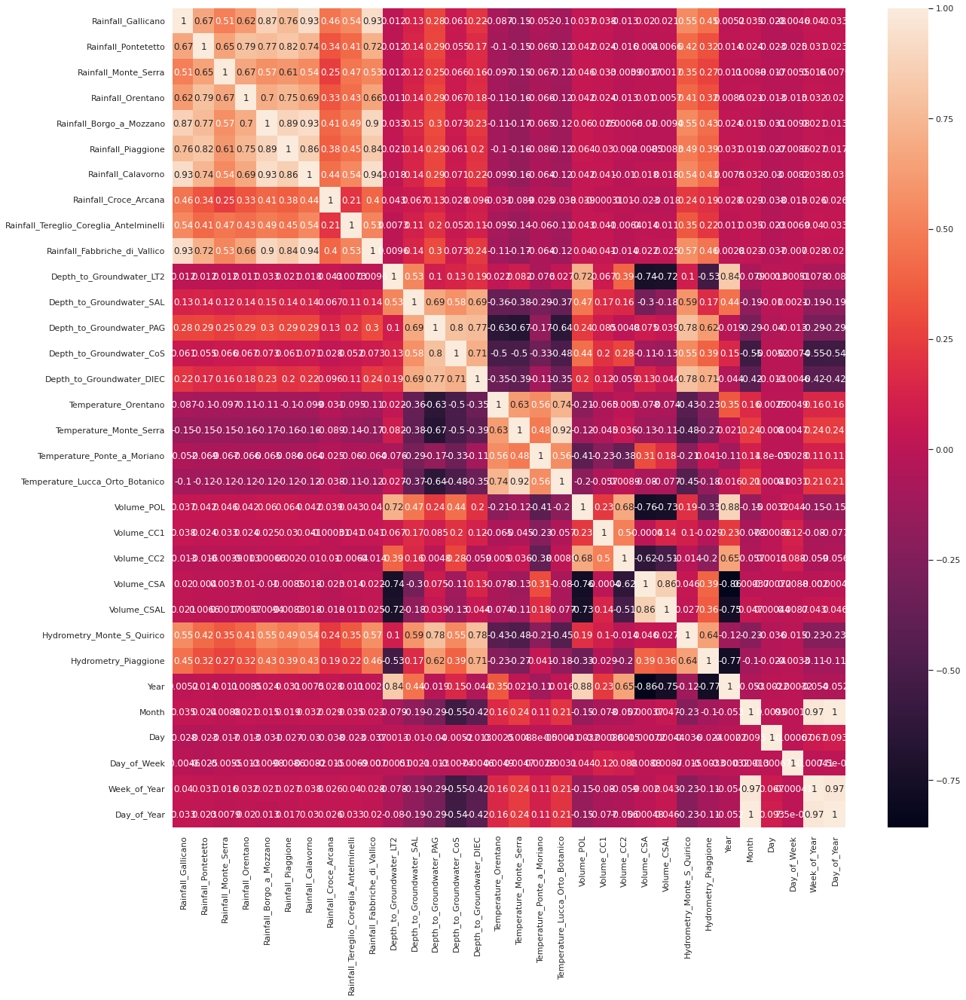

In [8]:
sns.set(rc={'figure.figsize':(20,20)})
sns.heatmap(aquifers.corr(),annot=True)

The image above explains the correlation between features.

# Missing and '0' Data Analysis

In [9]:
pd.Series(aquifers.isnull().sum()).rename_axis('Features').to_frame('Missing Value Count')

,Missing Value Count
Features,
Date,0
Rainfall_Gallicano,2859
Rainfall_Pontetetto,2859
Rainfall_Monte_Serra,2865
Rainfall_Orentano,2859
Rainfall_Borgo_a_Mozzano,2859
Rainfall_Piaggione,3224
Rainfall_Calavorno,2859
Rainfall_Croce_Arcana,2859


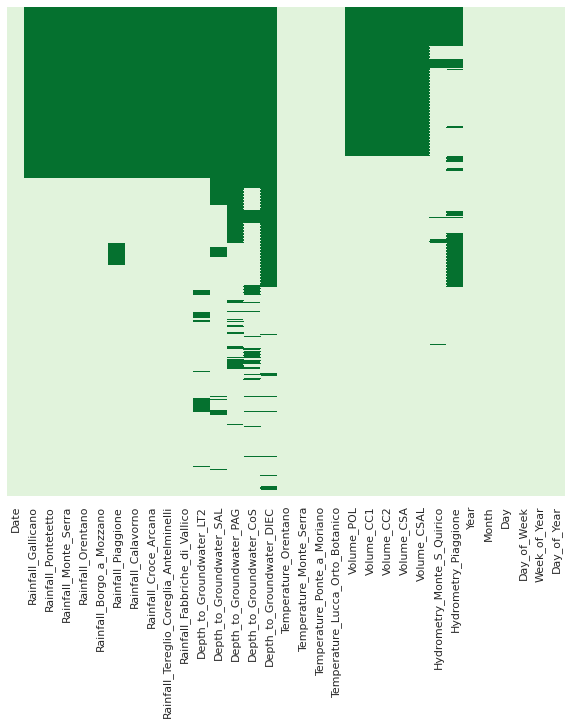

In [10]:
sns.set(rc={'figure.figsize':(10,9)})
colormap = sns.color_palette("Greens")
sns.heatmap(aquifers.isnull(),yticklabels=False,cbar=False, cmap = colormap )

#### A whole lot of values are missing until 2009. We will exclude them from our data

In [11]:
df = aquifers[aquifers['Year'].isin([2009, 2010, 2011,2012,2013,2014,2015,2016,2017,2018,2019,2020])]
df.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day,Day_of_Week,Week_of_Year,Day_of_Year
3955,2009-01-01,42.4,19.6,11.6,5.2,54.0,NaN,52.4,3.2,19.2,...,0.0,0.0,0.48,NaN,2009,1,1,3,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,0.2,NaN,2.8,1.6,0.0,...,0.0,0.0,0.48,NaN,2009,1,2,4,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.0,NaN,0.0,0.6,0.0,...,0.0,0.0,0.44,NaN,2009,1,3,5,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,NaN,0.2,0.0,0.0,...,0.0,0.0,0.39,NaN,2009,1,4,6,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,...,0.0,0.0,0.35,NaN,2009,1,5,0,2,5


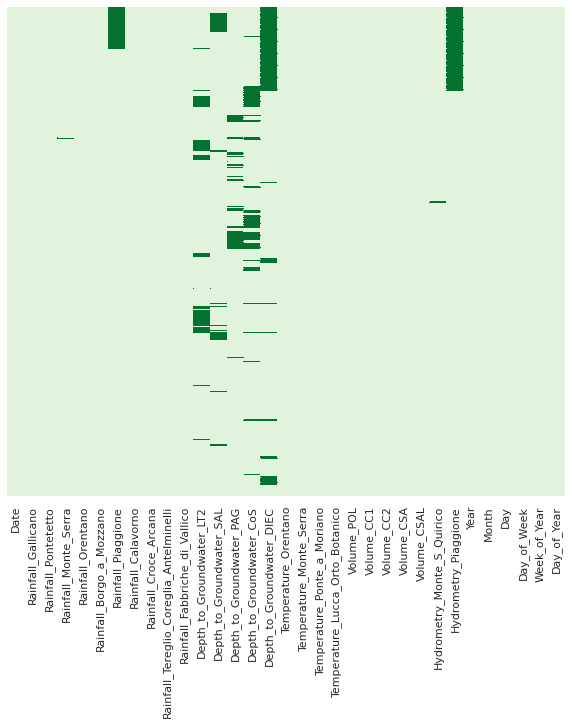

In [12]:
sns.set(rc={'figure.figsize':(10,9)})
colormap = sns.color_palette("Greens")
sns.heatmap(df.isnull(),yticklabels=False,cbar=False, cmap = colormap )

In [13]:
tg1 = df['Depth_to_Groundwater_SAL']
tg2 = df['Depth_to_Groundwater_CoS']
tg3 = df['Depth_to_Groundwater_LT2']


In [14]:
tg1_level = df.groupby(["Year", "Month"]).Depth_to_Groundwater_SAL.mean().reset_index()
tg1_level.head()

,Year,Month,Depth_to_Groundwater_SAL
0,2009,1,-5.323548
1,2009,2,-4.838571
2,2009,3,-4.593333
3,2009,4,NaN
4,2009,5,NaN


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


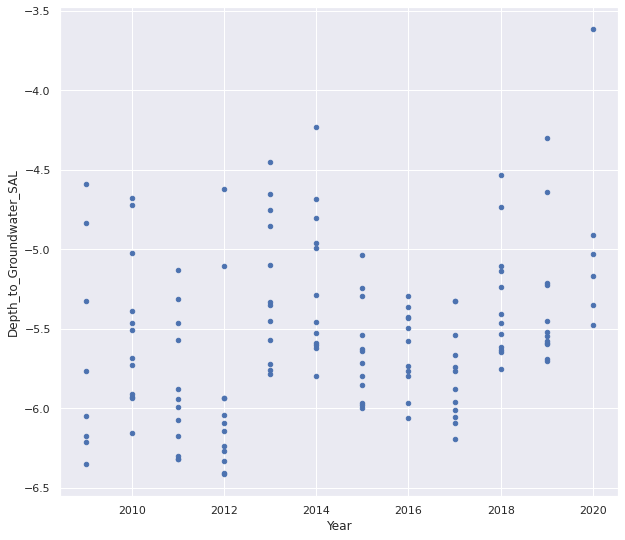

In [15]:
tg1_level.plot.scatter(x='Year', y = 'Depth_to_Groundwater_SAL')

In [16]:
tg1_level.max()

Year                        2020.000000
Month                         12.000000
Depth_to_Groundwater_SAL      -3.617667
dtype: float64

In [17]:
tg2_level = df.groupby(["Year", "Month"]).Depth_to_Groundwater_CoS.mean().reset_index()
tg2_level.head()

,Year,Month,Depth_to_Groundwater_CoS
0,2009,1,-4.515484
1,2009,2,-4.520000
2,2009,3,-4.413226
3,2009,4,-4.359667
4,2009,5,-5.315484


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


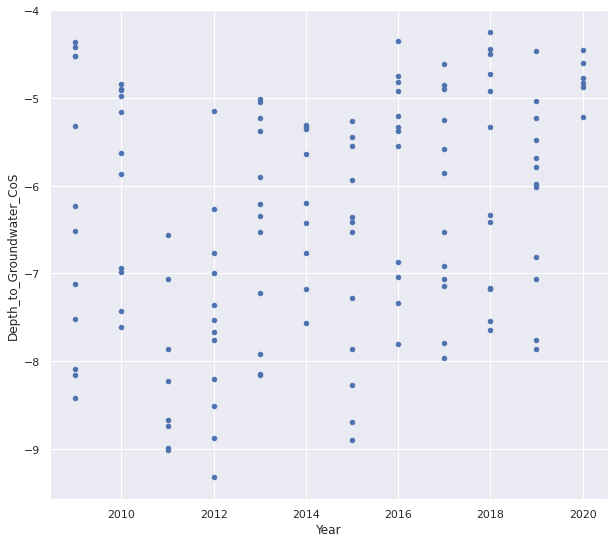

In [18]:
tg2_level.plot.scatter(x='Year', y = 'Depth_to_Groundwater_CoS')

In [19]:
tg2_level.max()

Year                        2020.000000
Month                         12.000000
Depth_to_Groundwater_CoS      -4.249677
dtype: float64

In [20]:
tg3_level = df.groupby(["Year", "Month"]).Depth_to_Groundwater_LT2.mean().reset_index()
tg3_level.head()

,Year,Month,Depth_to_Groundwater_LT2
0,2009,1,-14.490968
1,2009,2,-14.389286
2,2009,3,-14.237419
3,2009,4,-14.034333
4,2009,5,-14.048710


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


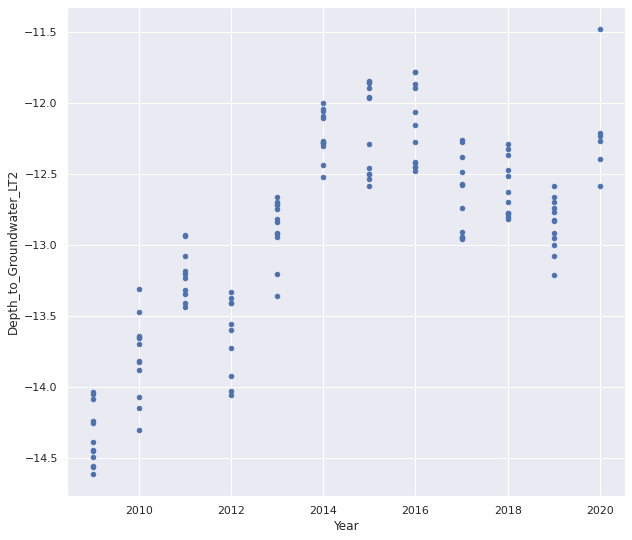

In [21]:
tg3_level.plot.scatter(x='Year', y = 'Depth_to_Groundwater_LT2')

In [22]:
tg3_level.max()

Year                        2020.000000
Month                         12.000000
Depth_to_Groundwater_LT2     -11.484333
dtype: float64

In [23]:
pd.set_option('display.max_columns', 500)
df.describe()

,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day,Day_of_Week,Week_of_Year,Day_of_Year
count,4199.000000,4199.000000,4193.000000,4199.000000,4199.000000,3834.000000,4199.000000,4199.000000,4199.000000,4199.000000,3707.000000,3909.000000,3807.000000,3617.000000,3270.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4190.000000,3462.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000,4199.000000
mean,5.157371,3.651488,4.043263,3.264825,4.806906,4.160276,4.748369,2.959514,4.347607,6.128412,-12.950674,-5.533622,-1.986302,-6.354271,-3.918639,15.065468,11.539628,10.554537,15.631019,-8541.623996,-16185.292991,-11622.168039,-3171.112960,-2676.705571,0.306002,-0.797614,2014.260062,6.392713,15.724935,3.000238,26.043344,179.121219
std,15.080130,10.284062,11.114854,8.941529,13.504281,11.344172,12.941979,9.610501,11.524565,16.942072,0.772275,0.585396,0.665692,1.390436,0.681753,7.026441,6.590020,8.855063,7.104202,1971.397188,1609.045951,1559.569020,2895.703491,2609.226802,0.231279,0.542261,3.325519,3.447469,8.798730,2.000417,15.042437,105.364054
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-14.660000,-6.480000,-3.380000,-9.570000,-4.990000,-4.650000,-7.850000,-2.850000,-3.300000,-12420.370580,-18601.920000,-14438.304000,-7757.258065,-9497.774194,0.000000,-1.190000,2009.000000,1.000000,1.000000,0.000000,1.000000,1.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-13.400000,-5.930000,-2.550000,-7.480000,-4.430000,9.475000,6.350000,0.000000,9.900000,-10080.645160,-16974.466950,-12726.720000,-5887.946774,-4668.677419,0.150000,-1.050000,2011.000000,3.000000,8.000000,1.000000,13.000000,88.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-12.800000,-5.610000,-1.970000,-6.330000,-4.060000,14.850000,11.100000,10.400000,15.400000,-8769.600000,-16396.992000,-11884.320000,-4478.833333,-3428.366129,0.240000,-0.990000,2014.000000,6.000000,16.000000,3.000000,26.000000,175.000000
75%,2.200000,1.200000,1.600000,1.000000,1.800000,1.600000,2.200000,1.400000,2.200000,2.800000,-12.430000,-5.240000,-1.510000,-5.120000,-3.550000,20.850000,16.700000,18.200000,21.650000,-6734.016000,-15785.280000,-10762.178400,0.000000,0.000000,0.390000,-0.860000,2017.000000,9.000000,23.000000,5.000000,39.000000,270.000000
max,318.800000,146.600000,152.200000,108.800000,176.600000,140.800000,209.000000,285.000000,147.200000,197.000000,0.000000,0.000000,-0.090000,0.000000,-1.030000,30.950000,28.100000,30.650000,30.350000,-4114.670400,-7149.791935,-5569.298387,0.000000,0.000000,2.170000,3.690000,2020.000000,12.000000,31.000000,6.000000,53.000000,366.000000


#### Let's see how our features pan out

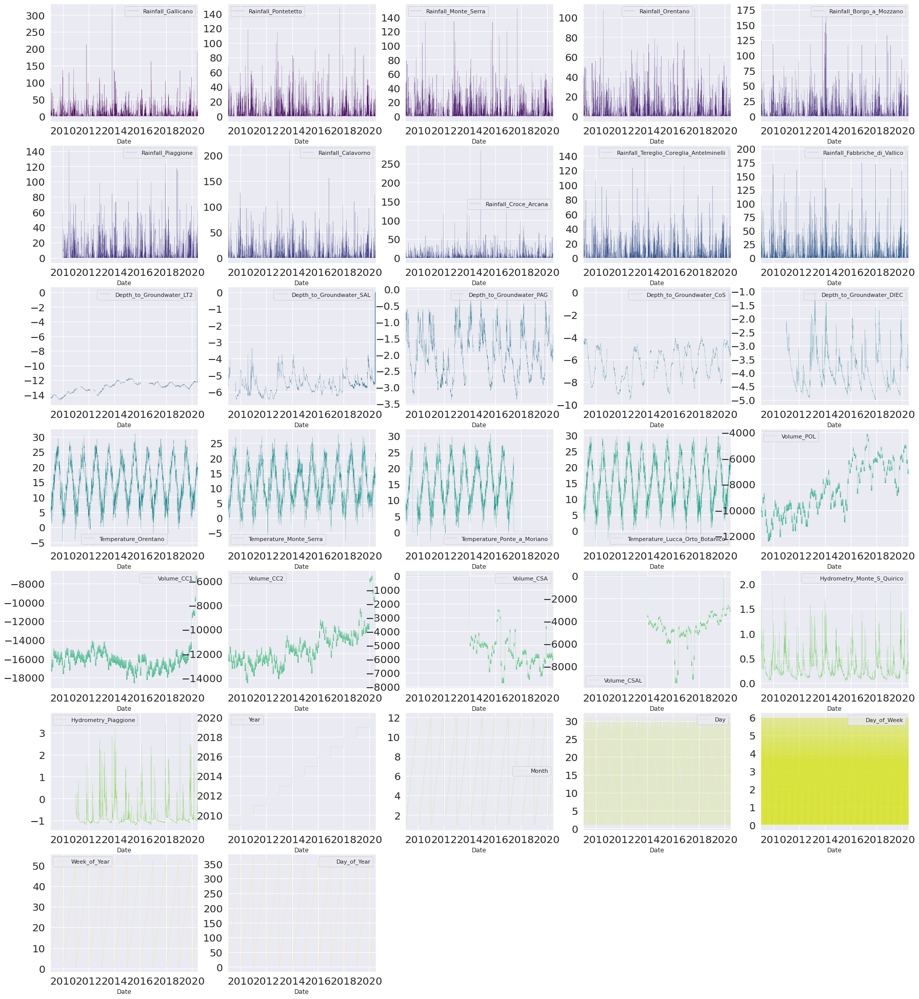

In [24]:
df.plot(subplots=True, layout=(10, 5), x = 'Date', figsize = (30,50), sharex=False, sharey=False, 
        colormap='viridis', fontsize=20,legend=True,linewidth=0.2);
#plt.tight_layout();

#### We can see that some features like 'Temperature_Ponte_a_Moriano', 'Volume_CSAL' and 'Volume_CSA' had entries of '0' for quite a while. This could mean that they actually had value of '0' or there was no data entry for them at all (i.e. null value). 

#### I'll choose the later reason because from other sources, temperature in Tucsany about these times was not 0. We would see the correlation with other temperatures and decide on what to do with the columns.


In [25]:
cop = df.copy()

## Temperatures

In [26]:
temp_df = df[['Temperature_Orentano', 'Temperature_Monte_Serra', 'Temperature_Ponte_a_Moriano', 'Temperature_Lucca_Orto_Botanico']].copy()
temp_df.head()

,Temperature_Orentano,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico
3955,2.25,3.90,5.25,2.70
3956,3.40,3.75,5.55,4.45
3957,4.70,-1.45,3.20,4.40
3958,-0.20,0.55,1.45,1.30
3959,-0.05,3.10,2.20,0.60


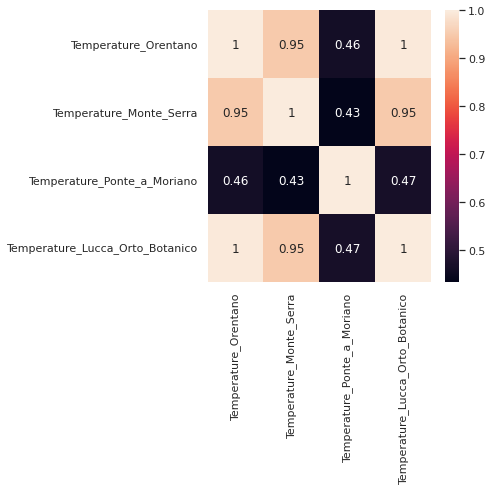

In [27]:
sns.set(rc={'figure.figsize':(5,5)})
sns.heatmap(temp_df.corr(),annot=True)

'Temperature_Monte_Serra', 'Temperature_Lucca_Orto_Botanico' have strong positive correlation with 'Temperature_Orentano'. I'll drop the columns.

In [28]:
temp_df = temp_df.drop(['Temperature_Monte_Serra', 'Temperature_Lucca_Orto_Botanico'], axis = 1)

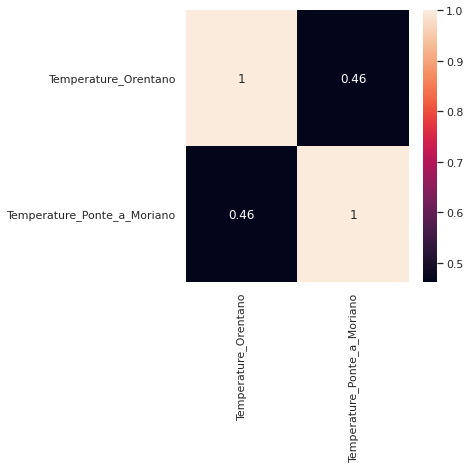

In [29]:
sns.set(rc={'figure.figsize':(5,5)})
sns.heatmap(temp_df.corr(),annot=True)

### Implement changes on our data frame

From our earlier plots, recall that these temperature and rainfall changes are seasonal. To that I'll use a function 'conditional_impute1' that will
- Replace the 0 values with nan
- Group by month and day of the year
- Find the mean/median of each group and 
- Fill the nan values with median in this case to account for outliers

In [30]:
df = df.drop(['Temperature_Monte_Serra', 'Temperature_Lucca_Orto_Botanico'], axis = 1)
df['Temperature_Ponte_a_Moriano'] = df['Temperature_Ponte_a_Moriano'].replace(0, np.nan)
df.head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day,Day_of_Week,Week_of_Year,Day_of_Year
3955,2009-01-01,42.4,19.6,11.6,5.2,54.0,NaN,52.4,3.2,19.2,69.4,-14.57,-5.23,-1.41,-4.56,NaN,2.25,5.25,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.48,NaN,2009,1,1,3,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,0.2,NaN,2.8,1.6,0.0,1.4,-14.54,-5.23,-1.37,-4.51,NaN,3.40,5.55,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.48,NaN,2009,1,2,4,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.0,NaN,0.0,0.6,0.0,0.2,-14.53,-5.27,-1.43,-4.53,NaN,4.70,3.20,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.44,NaN,2009,1,3,5,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,NaN,0.2,0.0,0.0,0.0,-14.53,-5.28,-1.49,-4.53,NaN,-0.20,1.45,-9671.612903,-15648.59613,-12005.0208,0.0,0.0,0.39,NaN,2009,1,4,6,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,-14.50,-5.33,-1.52,-4.54,NaN,-0.05,2.20,-10180.645160,-16472.20645,-12636.8640,0.0,0.0,0.35,NaN,2009,1,5,0,2,5


In [31]:
df.tail()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day,Day_of_Week,Week_of_Year,Day_of_Year
8149,2020-06-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-12.36,0.00,-2.04,0.00,-3.83,23.20,NaN,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0,0.20,-1.03,2020,6,26,4,26,178
8150,2020-06-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-12.36,-5.50,-2.10,-5.71,-3.84,23.60,NaN,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0,0.21,-1.03,2020,6,27,5,26,179
8151,2020-06-28,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-12.37,-5.49,-2.14,-5.73,-3.84,24.00,NaN,-6829.936207,-7455.505,-8724.261667,-5809.63,-3000.1,0.23,-1.03,2020,6,28,6,26,180
8152,2020-06-29,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-12.36,-5.50,-2.15,-5.73,-3.84,22.40,NaN,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0,0.23,-1.02,2020,6,29,0,27,181
8153,2020-06-30,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-12.38,-5.56,-2.17,-5.76,-3.85,23.95,NaN,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0,0.21,-1.05,2020,6,30,1,27,182


In [32]:

def conditional_impute1(input_df, col, choice='mean'):
    # your code here
    output_df = input_df
    missing = output_df[output_df[col].isnull()]
    meaner = output_df.groupby(['Month','Day'])[col].mean()
    medianer = output_df.groupby(['Month','Day'])[col].median()
    def fill_missing_mean(row):
        if pd.isnull(row[col]):
            return meaner[row['Month'],row['Day']]
        else:
            return row[col]
    
    def fill_missing_meadian(row):
        if pd.isnull(row[col]):
            return medianer[row['Month'],row['Day']]
        else:
            return row[col]
    
    if choice == 'mean':
        output_df[col] = output_df.apply(fill_missing_mean, axis=1)
    elif choice == 'median':
        output_df[col] = output_df.apply(fill_missing_meadian, axis=1)
    
    return output_df

In [33]:
conditional_impute1(df, 'Temperature_Ponte_a_Moriano', choice='median')

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day,Day_of_Week,Week_of_Year,Day_of_Year
3955,2009-01-01,42.4,19.6,11.6,5.2,54.0,NaN,52.4,3.2,19.2,69.4,-14.57,-5.23,-1.41,-4.56,NaN,2.25,5.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.48,NaN,2009,1,1,3,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,0.2,NaN,2.8,1.6,0.0,1.4,-14.54,-5.23,-1.37,-4.51,NaN,3.40,5.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.48,NaN,2009,1,2,4,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.0,NaN,0.0,0.6,0.0,0.2,-14.53,-5.27,-1.43,-4.53,NaN,4.70,3.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.44,NaN,2009,1,3,5,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,NaN,0.2,0.0,0.0,0.0,-14.53,-5.28,-1.49,-4.53,NaN,-0.20,1.450,-9671.612903,-15648.596130,-12005.020800,0.000000,0.000000,0.39,NaN,2009,1,4,6,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,-14.50,-5.33,-1.52,-4.54,NaN,-0.05,2.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.35,NaN,2009,1,5,0,2,5
3960,2009-01-06,0.0,0.2,1.0,0.0,0.2,NaN,0.0,0.0,1.4,0.0,-14.49,-5.37,-1.60,-4.65,NaN,1.00,4.500,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.36,NaN,2009,1,6,1,2,6
3961,2009-01-07,18.6,6.6,27.6,22.2,11.4,NaN,8.6,0.0,28.4,16.8,-14.49,-5.39,-1.48,-4.68,NaN,5.00,5.050,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.40,NaN,2009,1,7,2,2,7
3962,2009-01-08,33.6,22.4,9.4,0.2,29.0,NaN,26.0,0.0,0.2,37.4,-14.55,-5.41,-1.18,-4.69,NaN,4.60,6.150,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.47,NaN,2009,1,8,3,2,8
3963,2009-01-09,0.0,0.0,0.0,0.0,0.2,NaN,0.2,0.0,0.2,0.0,-14.59,-5.43,-1.26,-4.69,NaN,6.80,4.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.43,NaN,2009,1,9,4,2,9
3964,2009-01-10,0.0,0.0,0.0,0.0,0.0,NaN,0.2,0.0,0.0,0.0,-14.57,-5.43,-1.35,-4.67,NaN,3.65,6.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.40,NaN,2009,1,10,5,2,10


#### Temperature, without missing values

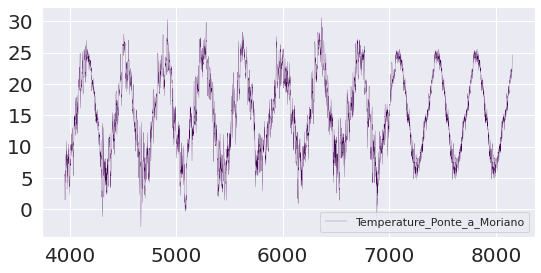

In [34]:
df.Temperature_Ponte_a_Moriano.plot(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False, 
        colormap='viridis', fontsize=20,legend=True,linewidth=0.2);

In [35]:
df.isnull().sum()

Date                                         0
Rainfall_Gallicano                           0
Rainfall_Pontetetto                          0
Rainfall_Monte_Serra                         6
Rainfall_Orentano                            0
Rainfall_Borgo_a_Mozzano                     0
Rainfall_Piaggione                         365
Rainfall_Calavorno                           0
Rainfall_Croce_Arcana                        0
Rainfall_Tereglio_Coreglia_Antelminelli      0
Rainfall_Fabbriche_di_Vallico                0
Depth_to_Groundwater_LT2                   492
Depth_to_Groundwater_SAL                   290
Depth_to_Groundwater_PAG                   392
Depth_to_Groundwater_CoS                   582
Depth_to_Groundwater_DIEC                  929
Temperature_Orentano                         0
Temperature_Ponte_a_Moriano                  0
Volume_POL                                   0
Volume_CC1                                   0
Volume_CC2                                   0
Volume_CSA   

## Rainfall

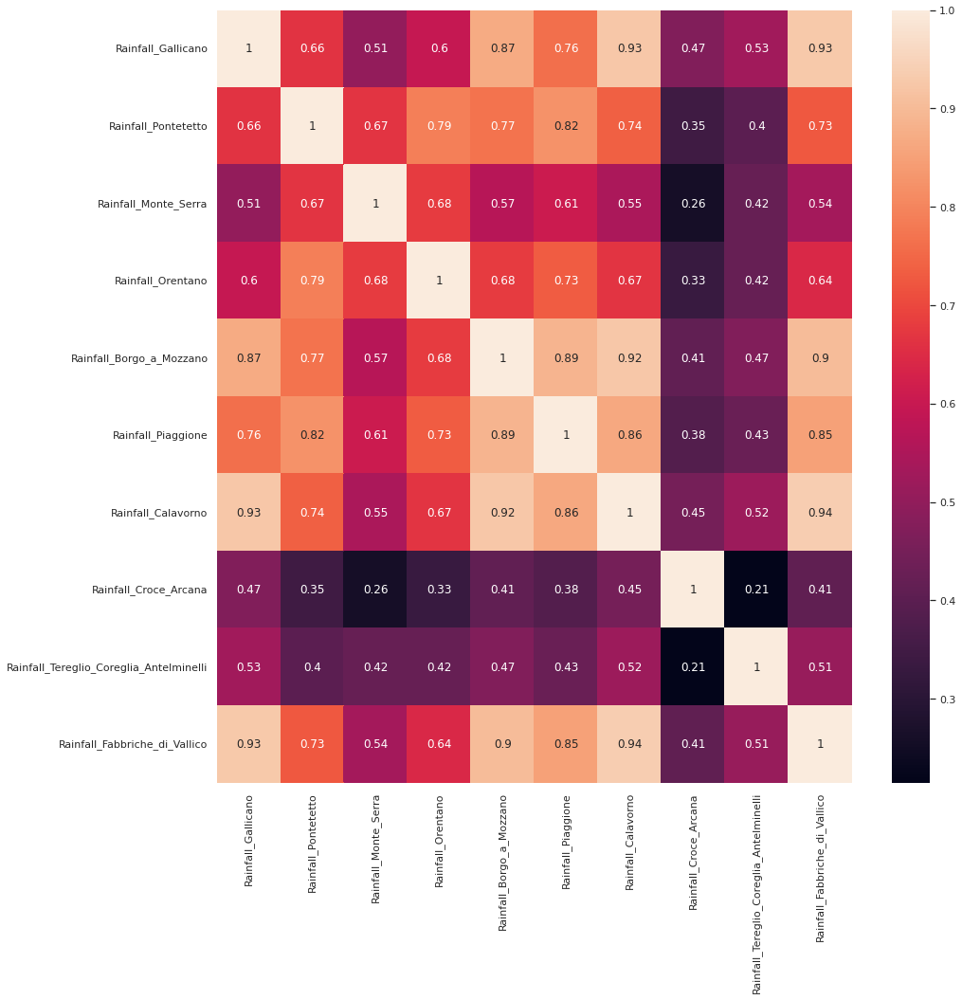

In [36]:
rain_df = df[['Rainfall_Gallicano','Rainfall_Pontetetto','Rainfall_Monte_Serra','Rainfall_Orentano','Rainfall_Borgo_a_Mozzano',
             'Rainfall_Piaggione','Rainfall_Calavorno','Rainfall_Croce_Arcana','Rainfall_Tereglio_Coreglia_Antelminelli',
             'Rainfall_Fabbriche_di_Vallico']]
sns.set(rc={'figure.figsize':(15,15)})
sns.heatmap(rain_df.corr(),annot=True)

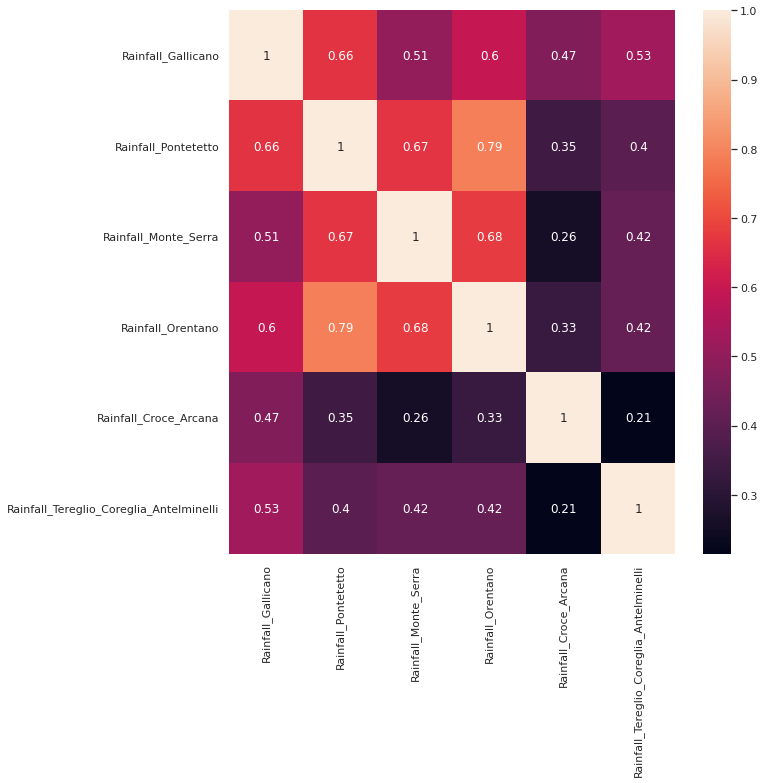

In [37]:
rain_df = rain_df.drop(['Rainfall_Fabbriche_di_Vallico', 'Rainfall_Calavorno','Rainfall_Piaggione','Rainfall_Borgo_a_Mozzano'], axis = 1)
sns.set(rc={'figure.figsize':(10,10)})
sns.heatmap(rain_df.corr(),annot=True)

### Implementing changes on our data frame

In [38]:
df = df.drop(['Rainfall_Fabbriche_di_Vallico', 'Rainfall_Calavorno','Rainfall_Piaggione','Rainfall_Borgo_a_Mozzano'], axis = 1)


In [39]:
pd.Series(df.isnull().sum()).rename_axis('Features').to_frame('Missing Value Count')

,Missing Value Count
Features,
Date,0
Rainfall_Gallicano,0
Rainfall_Pontetetto,0
Rainfall_Monte_Serra,6
Rainfall_Orentano,0
Rainfall_Croce_Arcana,0
Rainfall_Tereglio_Coreglia_Antelminelli,0
Depth_to_Groundwater_LT2,492
Depth_to_Groundwater_SAL,290


In [40]:
conditional_impute1(df, 'Rainfall_Monte_Serra', choice='median')

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day,Day_of_Week,Week_of_Year,Day_of_Year
3955,2009-01-01,42.4,19.6,11.6,5.2,3.2,19.2,-14.57,-5.23,-1.41,-4.56,NaN,2.25,5.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.48,NaN,2009,1,1,3,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,1.6,0.0,-14.54,-5.23,-1.37,-4.51,NaN,3.40,5.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.48,NaN,2009,1,2,4,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.6,0.0,-14.53,-5.27,-1.43,-4.53,NaN,4.70,3.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.44,NaN,2009,1,3,5,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,0.0,-14.53,-5.28,-1.49,-4.53,NaN,-0.20,1.450,-9671.612903,-15648.596130,-12005.020800,0.000000,0.000000,0.39,NaN,2009,1,4,6,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,0.0,-14.50,-5.33,-1.52,-4.54,NaN,-0.05,2.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.35,NaN,2009,1,5,0,2,5
3960,2009-01-06,0.0,0.2,1.0,0.0,0.0,1.4,-14.49,-5.37,-1.60,-4.65,NaN,1.00,4.500,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.36,NaN,2009,1,6,1,2,6
3961,2009-01-07,18.6,6.6,27.6,22.2,0.0,28.4,-14.49,-5.39,-1.48,-4.68,NaN,5.00,5.050,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.40,NaN,2009,1,7,2,2,7
3962,2009-01-08,33.6,22.4,9.4,0.2,0.0,0.2,-14.55,-5.41,-1.18,-4.69,NaN,4.60,6.150,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.47,NaN,2009,1,8,3,2,8
3963,2009-01-09,0.0,0.0,0.0,0.0,0.0,0.2,-14.59,-5.43,-1.26,-4.69,NaN,6.80,4.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.43,NaN,2009,1,9,4,2,9
3964,2009-01-10,0.0,0.0,0.0,0.0,0.0,0.0,-14.57,-5.43,-1.35,-4.67,NaN,3.65,6.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.40,NaN,2009,1,10,5,2,10


## Hydrometry

In [41]:
hyd_df = df[['Date','Hydrometry_Monte_S_Quirico' ,'Hydrometry_Piaggione']]

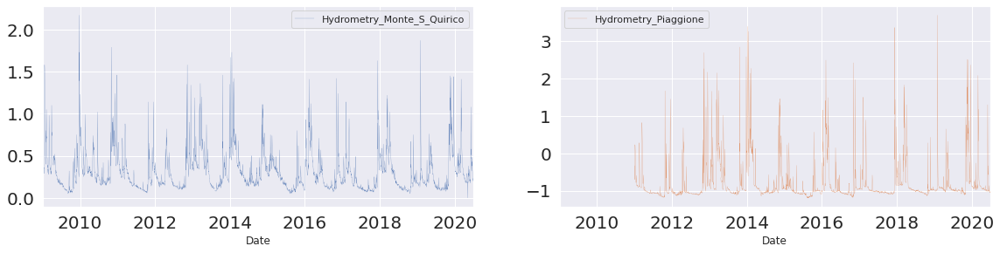

In [42]:
hyd_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

In [43]:
conditional_impute1(df, 'Hydrometry_Piaggione', choice='mean')
conditional_impute1(df, 'Hydrometry_Monte_S_Quirico', choice='mean')

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day,Day_of_Week,Week_of_Year,Day_of_Year
3955,2009-01-01,42.4,19.6,11.6,5.2,3.2,19.2,-14.57,-5.23,-1.41,-4.56,NaN,2.25,5.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.480000,-0.818000,2009,1,1,3,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,1.6,0.0,-14.54,-5.23,-1.37,-4.51,NaN,3.40,5.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.480000,-0.780000,2009,1,2,4,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.6,0.0,-14.53,-5.27,-1.43,-4.53,NaN,4.70,3.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.440000,-0.715000,2009,1,3,5,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,0.0,-14.53,-5.28,-1.49,-4.53,NaN,-0.20,1.450,-9671.612903,-15648.596130,-12005.020800,0.000000,0.000000,0.390000,-0.685000,2009,1,4,6,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,0.0,-14.50,-5.33,-1.52,-4.54,NaN,-0.05,2.200,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.350000,-0.442000,2009,1,5,0,2,5
3960,2009-01-06,0.0,0.2,1.0,0.0,0.0,1.4,-14.49,-5.37,-1.60,-4.65,NaN,1.00,4.500,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.360000,-0.573000,2009,1,6,1,2,6
3961,2009-01-07,18.6,6.6,27.6,22.2,0.0,28.4,-14.49,-5.39,-1.48,-4.68,NaN,5.00,5.050,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.400000,-0.615000,2009,1,7,2,2,7
3962,2009-01-08,33.6,22.4,9.4,0.2,0.0,0.2,-14.55,-5.41,-1.18,-4.69,NaN,4.60,6.150,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.470000,-0.660000,2009,1,8,3,2,8
3963,2009-01-09,0.0,0.0,0.0,0.0,0.0,0.2,-14.59,-5.43,-1.26,-4.69,NaN,6.80,4.250,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.430000,-0.725000,2009,1,9,4,2,9
3964,2009-01-10,0.0,0.0,0.0,0.0,0.0,0.0,-14.57,-5.43,-1.35,-4.67,NaN,3.65,6.550,-10180.645160,-16472.206450,-12636.864000,0.000000,0.000000,0.400000,-0.612000,2009,1,10,5,2,10


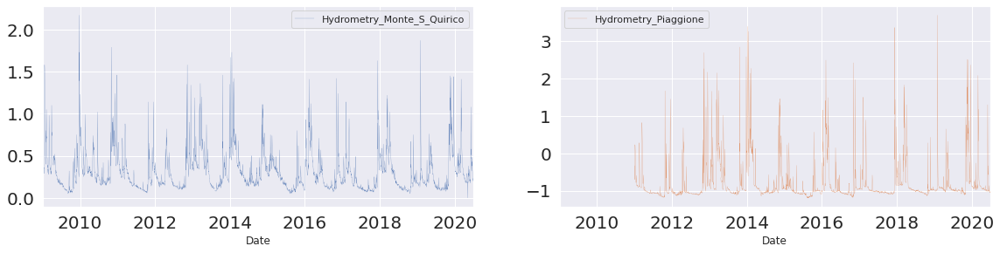

In [44]:
hyd_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

In [45]:
pd.Series(df.isnull().sum()).rename_axis('Features').to_frame('Missing Value Count')

,Missing Value Count
Features,
Date,0
Rainfall_Gallicano,0
Rainfall_Pontetetto,0
Rainfall_Monte_Serra,0
Rainfall_Orentano,0
Rainfall_Croce_Arcana,0
Rainfall_Tereglio_Coreglia_Antelminelli,0
Depth_to_Groundwater_LT2,492
Depth_to_Groundwater_SAL,290


## Volumes

In [46]:
vol_df = df[['Date', 'Day_of_Week','Year','Volume_POL' ,'Volume_CC1', 'Volume_CC2', 'Volume_CSA', 'Volume_CSAL']]
vol_df.head()

,Date,Day_of_Week,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL
3955,2009-01-01,3,2009,-10180.645160,-16472.20645,-12636.8640,0.0,0.0
3956,2009-01-02,4,2009,-10180.645160,-16472.20645,-12636.8640,0.0,0.0
3957,2009-01-03,5,2009,-10180.645160,-16472.20645,-12636.8640,0.0,0.0
3958,2009-01-04,6,2009,-9671.612903,-15648.59613,-12005.0208,0.0,0.0
3959,2009-01-05,0,2009,-10180.645160,-16472.20645,-12636.8640,0.0,0.0


In [47]:
vol_df.tail()

,Date,Day_of_Week,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL
8149,2020-06-26,4,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8150,2020-06-27,5,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8151,2020-06-28,6,2020,-6829.936207,-7455.505,-8724.261667,-5809.63,-3000.1
8152,2020-06-29,0,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8153,2020-06-30,1,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0


#### Replacing 0 with Nan then finding patterns

In [48]:
vol_df['Volume_POL'] = vol_df['Volume_POL'].replace(0, np.nan)
vol_df['Volume_CC1'] = vol_df['Volume_CC1'].replace(0, np.nan)
vol_df['Volume_CC2'] = vol_df['Volume_CC2'].replace(0, np.nan)
vol_df['Volume_CSA'] = vol_df['Volume_CSA'].replace(0, np.nan)
vol_df['Volume_CSAL'] = vol_df['Volume_CSAL'].replace(0, np.nan)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documen

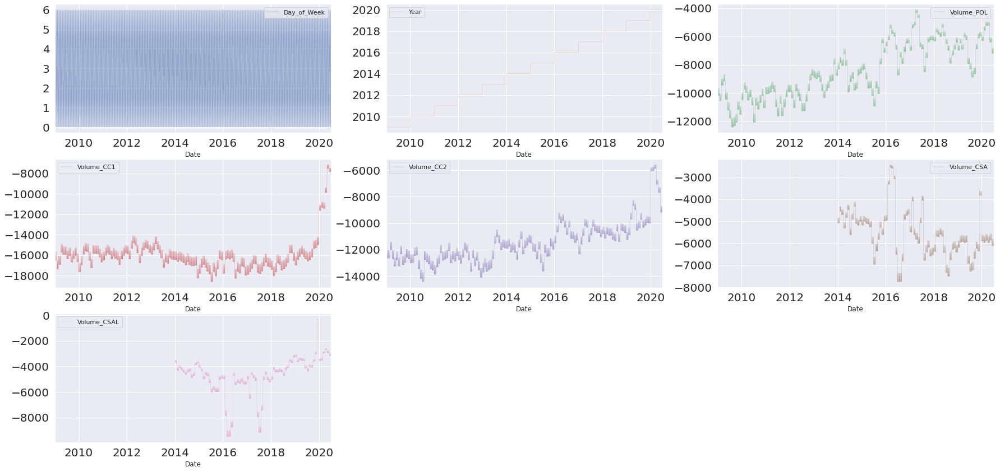

In [49]:
vol_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

In [50]:
vol_df.head()

,Date,Day_of_Week,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL
3955,2009-01-01,3,2009,-10180.645160,-16472.20645,-12636.8640,NaN,NaN
3956,2009-01-02,4,2009,-10180.645160,-16472.20645,-12636.8640,NaN,NaN
3957,2009-01-03,5,2009,-10180.645160,-16472.20645,-12636.8640,NaN,NaN
3958,2009-01-04,6,2009,-9671.612903,-15648.59613,-12005.0208,NaN,NaN
3959,2009-01-05,0,2009,-10180.645160,-16472.20645,-12636.8640,NaN,NaN


In [51]:
vol_df.tail()

,Date,Day_of_Week,Year,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL
8149,2020-06-26,4,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8150,2020-06-27,5,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8151,2020-06-28,6,2020,-6829.936207,-7455.505,-8724.261667,-5809.63,-3000.1
8152,2020-06-29,0,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0
8153,2020-06-30,1,2020,-7189.406533,-7847.900,-9183.433333,-6115.40,-3158.0


In [52]:
df['Volume_POL'] = df['Volume_POL'].replace(0, np.nan)
df['Volume_CC1'] = df['Volume_CC1'].replace(0, np.nan)
df['Volume_CC2'] = df['Volume_CC2'].replace(0, np.nan)
df['Volume_CSA'] = df['Volume_CSA'].replace(0, np.nan)
df['Volume_CSAL'] = df['Volume_CSAL'].replace(0, np.nan)

In [53]:
vol_df.isnull().sum()

Date              0
Day_of_Week       0
Year              0
Volume_POL        0
Volume_CC1        0
Volume_CC2        0
Volume_CSA     1826
Volume_CSAL    1826
dtype: int64

#### Attempt to find missing values using ML

In [54]:
df_csa = vol_df[['Year','Day_of_Week','Volume_POL','Volume_CC1', 'Volume_CC2', 'Volume_CSA']]
df_csal = vol_df[['Year',  'Day_of_Week', 'Volume_POL' ,'Volume_CC1', 'Volume_CC2', 'Volume_CSAL']]

In [55]:
#Test Data for Volume_CSA

tdf_csa = df_csa[df_csa.Volume_CSA.isnull()]
df_csa.dropna(inplace = True)

/usr/local/lib/python3.7/dist-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [56]:
x_train = df_csa.drop('Volume_CSA', axis = 1)
y_train = df_csa['Volume_CSA']
x_test = tdf_csa[['Year','Day_of_Week','Volume_POL' ,'Volume_CC1', 'Volume_CC2']]

In [57]:
import xgboost as xgb
xg = xgb.XGBRegressor()

xg.fit(x_train, y_train)
y_pred = xg.predict(x_test)
tdf_csa['Volume_CSA'] = y_pred

[11:55:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [58]:
tdf_csa.head()

,Year,Day_of_Week,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA
3955,2009,3,-10180.645160,-16472.20645,-12636.8640,-4778.789062
3956,2009,4,-10180.645160,-16472.20645,-12636.8640,-4778.789062
3957,2009,5,-10180.645160,-16472.20645,-12636.8640,-4778.789062
3958,2009,6,-9671.612903,-15648.59613,-12005.0208,-4801.178711
3959,2009,0,-10180.645160,-16472.20645,-12636.8640,-4778.789062


In [59]:
tdf_csa.tail()

,Year,Day_of_Week,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA
5776,2013,4,-8769.60,-16421.70240,-11884.320,-5126.270996
5777,2013,5,-8769.60,-16421.70240,-11884.320,-5126.270996
5778,2013,6,-8331.12,-15600.61728,-11290.104,-4796.066895
5779,2013,0,-8769.60,-16421.70240,-11884.320,-5126.270996
5780,2013,1,-8769.60,-16421.70240,-11884.320,-5126.270996


In [60]:
#Train and Test Data for Volume_CSAl

tdf_csal = df_csal[df_csal.Volume_CSAL.isnull()]
df_csal.dropna(inplace = True)
xx_train = df_csal.drop('Volume_CSAL', axis = 1)
yy_train = df_csal['Volume_CSAL']

/usr/local/lib/python3.7/dist-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [61]:
xg.fit(xx_train, yy_train)
xx_test = tdf_csal[['Year', 'Day_of_Week','Volume_POL' ,'Volume_CC1', 'Volume_CC2']]
yy_pred = xg.predict(x_test)

tdf_csal['Volume_CSAL'] = yy_pred
tdf_csal.tail()

[11:55:23] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,Year,Day_of_Week,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSAL
5776,2013,4,-8769.60,-16421.70240,-11884.320,-4133.736328
5777,2013,5,-8769.60,-16421.70240,-11884.320,-4133.736328
5778,2013,6,-8331.12,-15600.61728,-11290.104,-3732.481934
5779,2013,0,-8769.60,-16421.70240,-11884.320,-4133.736328
5780,2013,1,-8769.60,-16421.70240,-11884.320,-4133.736328


In [62]:
# Create a new df to hold original and predicted volumes
vol_pred = pd.concat([tdf_csa.Volume_CSA, tdf_csal.Volume_CSAL ], axis = 1)
vol_orig = pd.concat([df_csa.Volume_CSA, df_csal.Volume_CSAL ], axis = 1)

vol_new = pd.concat([vol_pred, vol_orig ])

In [63]:
# Replacing missing volumes in original data frames

df['Volume_CSA'] = vol_new['Volume_CSA']
df['Volume_CSAL'] = vol_new['Volume_CSAL']
vol_df['Volume_CSA'] = vol_new['Volume_CSA']
vol_df['Volume_CSAL'] = vol_new['Volume_CSAL']

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


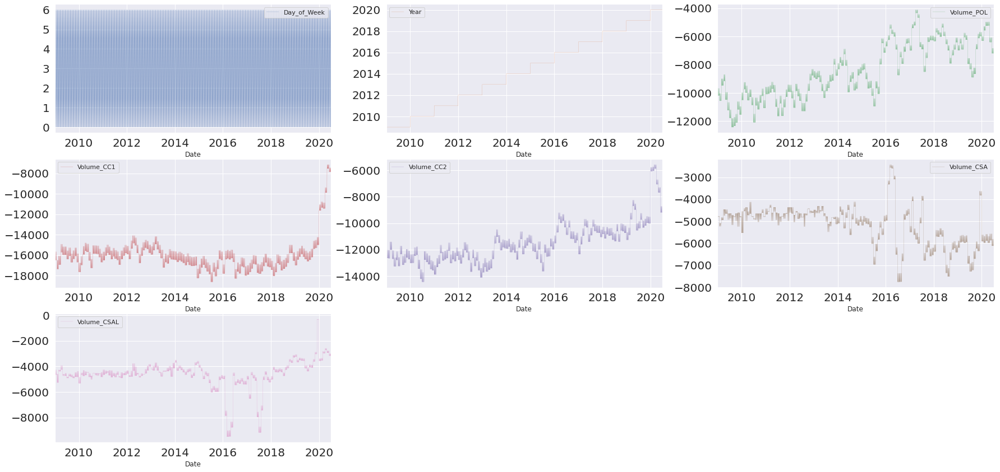

In [64]:
vol_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

## Depth to Groundwater

In [65]:
dtg_df = df[['Date','Year','Month','Day','Depth_to_Groundwater_LT2' ,'Depth_to_Groundwater_SAL', 
             'Depth_to_Groundwater_PAG', 'Depth_to_Groundwater_CoS', 'Depth_to_Groundwater_DIEC']]
dtg_df.head()

,Date,Year,Month,Day,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC
3955,2009-01-01,2009,1,1,-14.57,-5.23,-1.41,-4.56,NaN
3956,2009-01-02,2009,1,2,-14.54,-5.23,-1.37,-4.51,NaN
3957,2009-01-03,2009,1,3,-14.53,-5.27,-1.43,-4.53,NaN
3958,2009-01-04,2009,1,4,-14.53,-5.28,-1.49,-4.53,NaN
3959,2009-01-05,2009,1,5,-14.50,-5.33,-1.52,-4.54,NaN


In [66]:
pd.Series(dtg_df.isnull().sum()).rename_axis('Targets').to_frame('Missing Value Count')

,Missing Value Count
Targets,
Date,0
Year,0
Month,0
Day,0
Depth_to_Groundwater_LT2,492
Depth_to_Groundwater_SAL,290
Depth_to_Groundwater_PAG,392
Depth_to_Groundwater_CoS,582
Depth_to_Groundwater_DIEC,929


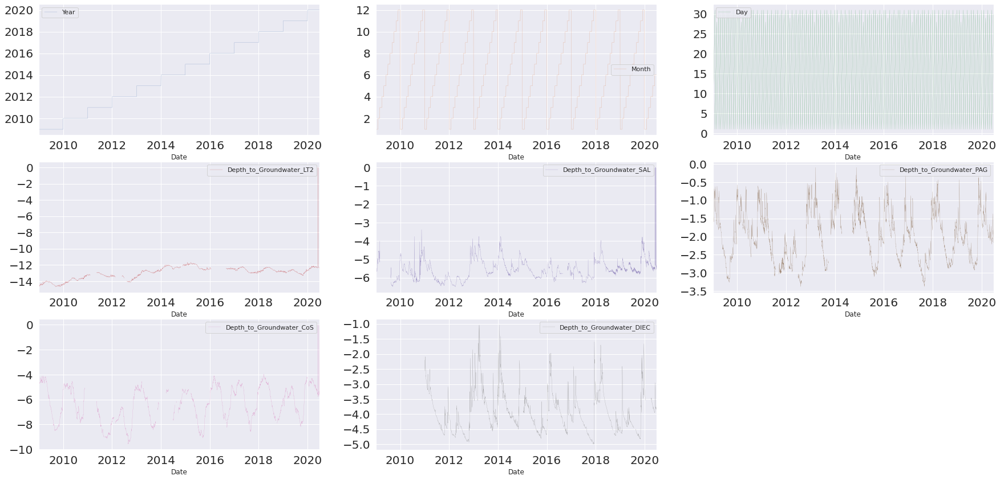

In [67]:
dtg_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

In [68]:
df['Depth_to_Groundwater_LT2'] = df['Depth_to_Groundwater_LT2'].replace(0, np.nan)
df['Depth_to_Groundwater_SAL'] = df['Depth_to_Groundwater_SAL'].replace(0, np.nan)
df['Depth_to_Groundwater_PAG'] = df['Depth_to_Groundwater_PAG'].replace(0, np.nan)
df['Depth_to_Groundwater_CoS'] = df['Depth_to_Groundwater_CoS'].replace(0, np.nan)
df['Depth_to_Groundwater_DIEC'] = df['Depth_to_Groundwater_DIEC'].replace(0, np.nan)

In [69]:
conditional_impute1(df, 'Depth_to_Groundwater_PAG', choice='median')
conditional_impute1(df, 'Depth_to_Groundwater_DIEC', choice='median')

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Depth_to_Groundwater_LT2,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_CoS,Depth_to_Groundwater_DIEC,Temperature_Orentano,Temperature_Ponte_a_Moriano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,Year,Month,Day,Day_of_Week,Week_of_Year,Day_of_Year
3955,2009-01-01,42.4,19.6,11.6,5.2,3.2,19.2,-14.57,-5.23,-1.410,-4.56,-3.785,2.25,5.250,-10180.645160,-16472.206450,-12636.864000,-4778.789062,-4647.735840,0.480000,-0.818000,2009,1,1,3,1,1
3956,2009-01-02,2.2,0.6,0.0,0.2,1.6,0.0,-14.54,-5.23,-1.370,-4.51,-3.710,3.40,5.550,-10180.645160,-16472.206450,-12636.864000,-4778.789062,-4647.735840,0.480000,-0.780000,2009,1,2,4,1,2
3957,2009-01-03,0.2,0.2,0.0,0.0,0.6,0.0,-14.53,-5.27,-1.430,-4.53,-3.550,4.70,3.200,-10180.645160,-16472.206450,-12636.864000,-4778.789062,-4647.735840,0.440000,-0.715000,2009,1,3,5,1,3
3958,2009-01-04,0.0,0.0,0.0,0.2,0.0,0.0,-14.53,-5.28,-1.490,-4.53,-3.420,-0.20,1.450,-9671.612903,-15648.596130,-12005.020800,-4801.178711,-4260.557617,0.390000,-0.685000,2009,1,4,6,1,4
3959,2009-01-05,0.0,0.0,0.0,0.0,0.0,0.0,-14.50,-5.33,-1.520,-4.54,-3.420,-0.05,2.200,-10180.645160,-16472.206450,-12636.864000,-4778.789062,-4647.735840,0.350000,-0.442000,2009,1,5,0,2,5
3960,2009-01-06,0.0,0.2,1.0,0.0,0.0,1.4,-14.49,-5.37,-1.600,-4.65,-3.440,1.00,4.500,-10180.645160,-16472.206450,-12636.864000,-4778.789062,-4647.735840,0.360000,-0.573000,2009,1,6,1,2,6
3961,2009-01-07,18.6,6.6,27.6,22.2,0.0,28.4,-14.49,-5.39,-1.480,-4.68,-3.460,5.00,5.050,-10180.645160,-16472.206450,-12636.864000,-4778.789062,-4647.735840,0.400000,-0.615000,2009,1,7,2,2,7
3962,2009-01-08,33.6,22.4,9.4,0.2,0.0,0.2,-14.55,-5.41,-1.180,-4.69,-3.490,4.60,6.150,-10180.645160,-16472.206450,-12636.864000,-4778.789062,-4647.735840,0.470000,-0.660000,2009,1,8,3,2,8
3963,2009-01-09,0.0,0.0,0.0,0.0,0.0,0.2,-14.59,-5.43,-1.260,-4.69,-3.550,6.80,4.250,-10180.645160,-16472.206450,-12636.864000,-4778.789062,-4647.735840,0.430000,-0.725000,2009,1,9,4,2,9
3964,2009-01-10,0.0,0.0,0.0,0.0,0.0,0.0,-14.57,-5.43,-1.350,-4.67,-3.600,3.65,6.550,-10180.645160,-16472.206450,-12636.864000,-4778.789062,-4647.735840,0.400000,-0.612000,2009,1,10,5,2,10


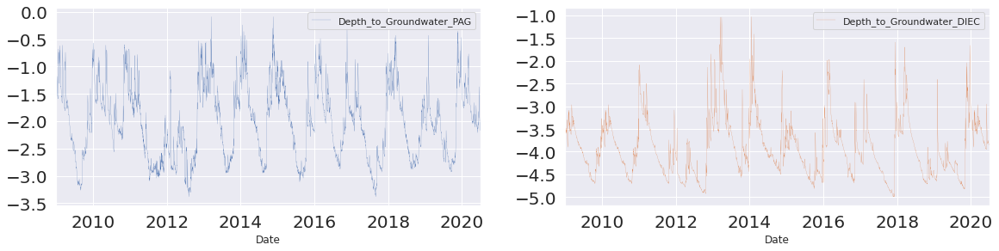

In [70]:
ndtg_df = df[['Date','Depth_to_Groundwater_PAG', 'Depth_to_Groundwater_DIEC']]
ndtg_df.plot.line(subplots=True, layout=(10, 3), x = 'Date', figsize = (30,50), sharex=False, sharey=False
                                                                , fontsize=20,legend=True,linewidth=0.2);

## EDA Summary

I've been able to fix all missing and 0 values in our data. However, I left the missing values in our targets to predict them at the end.

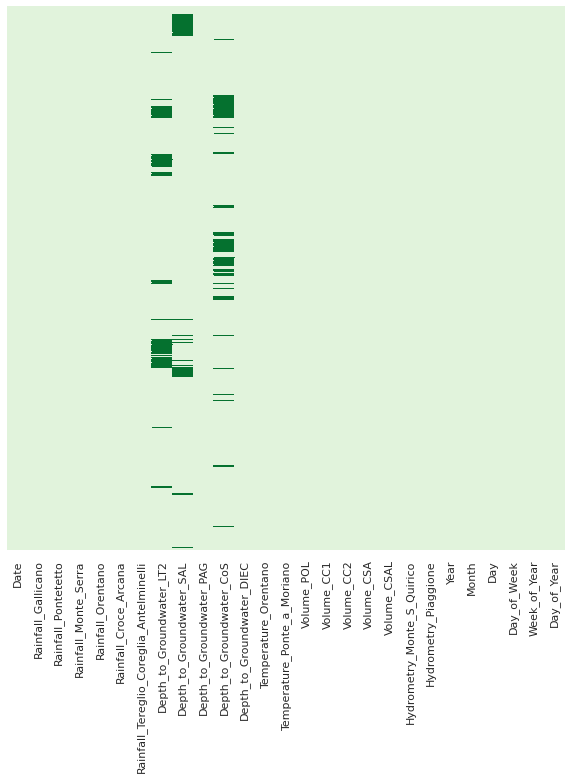

In [71]:
sns.set(rc={'figure.figsize':(10,10)})
colormap = sns.color_palette("Greens")
sns.heatmap(df.isnull(),yticklabels=False,cbar=False, cmap = colormap )

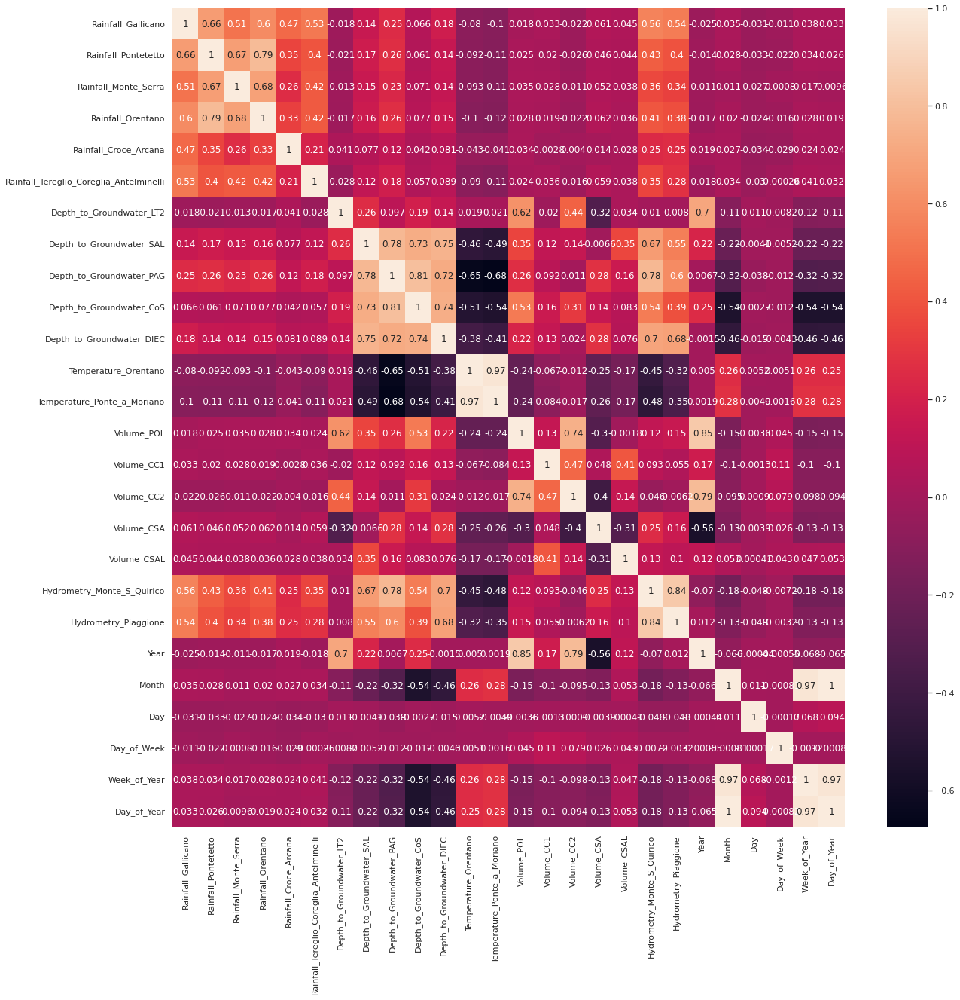

In [72]:
sns.set(rc={'figure.figsize':(20,20)})
sns.heatmap(df.corr(),annot=True)

In [73]:
ndf = df.copy()

In [74]:
ndf.to_csv('ndf.csv')

In [75]:
#DROPPING REDUNDANT COLUMNS
df = df.drop(['Temperature_Ponte_a_Moriano', 'Hydrometry_Piaggione','Week_of_Year', 'Day_of_Year', 'Date'], axis = 1)

In [76]:
# from sklearn.preprocessing import StandardScaler
# scaler = StandardScaler()
# df = pd.DataFrame(scaler.fit_transform(df),columns = df.columns)

In [77]:
a = df['Depth_to_Groundwater_SAL']
b = df['Depth_to_Groundwater_CoS']
c = df['Depth_to_Groundwater_LT2']

In [78]:
dfa = df.drop(['Depth_to_Groundwater_CoS', 'Depth_to_Groundwater_LT2'], axis=1)
dfb = df.drop(['Depth_to_Groundwater_SAL', 'Depth_to_Groundwater_LT2'], axis=1)
dfc = df.drop(['Depth_to_Groundwater_SAL', 'Depth_to_Groundwater_CoS'], axis=1)

#### I will make the missing values the test data and use the rest for train and validation

In [79]:
dfa_test = dfa[dfa.Depth_to_Groundwater_SAL.isnull()]
dfa.dropna(inplace = True)

dfb_test = dfb[dfb.Depth_to_Groundwater_CoS.isnull()]
dfb.dropna(inplace = True)

dfc_test = dfc[dfc.Depth_to_Groundwater_LT2.isnull()]
dfc.dropna(inplace = True)

### Modelling

In [80]:
#Import models
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn import linear_model
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb

from keras.models import Sequential
from keras.layers import Dense

#Model performance
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

### Depth to Groundwater - SAL

In [81]:
dfa.head()

,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Depth_to_Groundwater_SAL,Depth_to_Groundwater_PAG,Depth_to_Groundwater_DIEC,Temperature_Orentano,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Year,Month,Day,Day_of_Week
3955,42.4,19.6,11.6,5.2,3.2,19.2,-5.23,-1.41,-3.785,2.25,-10180.645160,-16472.20645,-12636.8640,-4778.789062,-4647.735840,0.48,2009,1,1,3
3956,2.2,0.6,0.0,0.2,1.6,0.0,-5.23,-1.37,-3.710,3.40,-10180.645160,-16472.20645,-12636.8640,-4778.789062,-4647.735840,0.48,2009,1,2,4
3957,0.2,0.2,0.0,0.0,0.6,0.0,-5.27,-1.43,-3.550,4.70,-10180.645160,-16472.20645,-12636.8640,-4778.789062,-4647.735840,0.44,2009,1,3,5
3958,0.0,0.0,0.0,0.2,0.0,0.0,-5.28,-1.49,-3.420,-0.20,-9671.612903,-15648.59613,-12005.0208,-4801.178711,-4260.557617,0.39,2009,1,4,6
3959,0.0,0.0,0.0,0.0,0.0,0.0,-5.33,-1.52,-3.420,-0.05,-10180.645160,-16472.20645,-12636.8640,-4778.789062,-4647.735840,0.35,2009,1,5,0


In [82]:
y1 = dfa['Depth_to_Groundwater_SAL']
x1 = dfa.drop('Depth_to_Groundwater_SAL', axis=1)

x1_train, x1_test, y1_train, y1_test = train_test_split(x1, y1, test_size=0.2, shuffle=False, random_state=0)

#### Regression Models

In [83]:
reg_names = ['Linear Regression', 'Decision Tree Regressor', 'Support Vector Regressor', 'XG Regressor',  'AdaBoost', 'Random Forest Regressor']
regressors = [LinearRegression(), DecisionTreeRegressor(),SVR(), xgb.XGBRegressor(), AdaBoostRegressor(), RandomForestRegressor()]

SAL1_reg = []
reg_models = {}

for name, clf in zip(reg_names, regressors):    
    print ('Fitting {:s} model...'.format(name))
    run_time = %timeit -q -o clf.fit(x1_train, y1_train)
    
    print ('... predicting')
    y1_pred = clf.predict(x1_train)   
    SAL_pred1 = clf.predict(x1_test)
    
    print ('... scoring')
    #Evaluating R^2 and RMSE values
    SAL1_R2 = r2_score(y1_test, SAL_pred1)
    SAL1_MSE = mean_squared_error(y1_test, SAL_pred1)
    SAL1_MAE = mean_absolute_error(y1_test, SAL_pred1)
    SAL1_RMSE = np.sqrt(mean_squared_error(y1_test, SAL_pred1))  
    
    # Save the results to dictionaries
    reg_models[name] = clf
    SAL1_reg.append([name, SAL1_R2, SAL1_MAE, SAL1_RMSE, run_time.best])

    
SAL1_df = pd.DataFrame(SAL1_reg, columns=['Regressor', 'R^2', 'MAE Value', 'RMSE Value', 'Train Time'])
SAL1_df.set_index('Regressor', inplace= True)

print ('... All done!')
display(SAL1_df)

Fitting Linear Regression model...
... predicting
... scoring
Fitting Decision Tree Regressor model...
... predicting
... scoring
Fitting Support Vector Regressor model...
... predicting
... scoring
Fitting XG Regressor model...
[11:55:56] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:55:56] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:55:56] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:55:57] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:55:57] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:55:57] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
... predi

,R^2,MAE Value,RMSE Value,Train Time
Regressor,,,,
Linear Regression,0.737852,0.151440,0.193995,0.005671
Decision Tree Regressor,0.289929,0.246359,0.319278,0.039829
Support Vector Regressor,-1.537626,0.422235,0.603575,0.508440
XG Regressor,0.551285,0.216443,0.253807,0.239648
AdaBoost,0.574356,0.204937,0.247196,0.445029
Random Forest Regressor,0.542651,0.209593,0.256237,2.406767


#### Neural Network

In [84]:
model = Sequential()
model.add(Dense(25, input_dim = 19, activation = 'relu'))
model.add(Dense(50, activation = 'relu'))
model.add(Dense(1, activation = 'linear'))

model.compile(optimizer = 'adam', loss = 'mean_absolute_error')
model.fit(x1_train, y1_train, epochs = 30, batch_size = 20, verbose = 1, validation_split = 0.2)

SAL_pred2 = model.predict(x1_test)
print('MAE :', mean_absolute_error(y1_test, SAL_pred2))
print('RMSE :', np.sqrt(mean_squared_error(y1_test, SAL_pred2)))

Epoch 1/30
125/125 [==============================] - 1s 6ms/step - loss: 476.1463 - val_loss: 49.0122
Epoch 2/30
125/125 [==============================] - 0s 3ms/step - loss: 22.4833 - val_loss: 21.8033
Epoch 3/30
125/125 [==============================] - 0s 3ms/step - loss: 25.3584 - val_loss: 17.9047
Epoch 4/30
125/125 [==============================] - 0s 3ms/step - loss: 16.4928 - val_loss: 11.9707
Epoch 5/30
125/125 [==============================] - 0s 3ms/step - loss: 18.0859 - val_loss: 17.6007
Epoch 6/30
125/125 [==============================] - 0s 3ms/step - loss: 26.7228 - val_loss: 13.9585
Epoch 7/30
125/125 [==============================] - 0s 3ms/step - loss: 23.9084 - val_loss: 14.6305
Epoch 8/30
125/125 [==============================] - 0s 3ms/step - loss: 22.5933 - val_loss: 10.1937
Epoch 9/30
125/125 [==============================] - 0s 3ms/step - loss: 22.5536 - val_loss: 43.1428
Epoch 10/30
125/125 [==============================] - 1s 7ms/step - loss: 18.562

#### The Linear Regression Model gives the least MAE and RMSE values in the best time. 

### Depth to Groundwater - CoS

In [85]:
y2 = dfb['Depth_to_Groundwater_CoS']
x2 = dfb.drop('Depth_to_Groundwater_CoS', axis=1)


x2_train, x2_test, y2_train, y2_test = train_test_split(x2, y2, test_size=0.2, shuffle=False, random_state=0)

#### Regression Models

In [86]:
# reg_names = ['Linear Regression', 'Decision Tree Regressor', 'Support Vector Regressor', 'XG Regressor',  'AdaBoost', 'Random Forest Regressor']
# regressors = [LinearRegression(), DecisionTreeRegressor(),SVR(), xgb.XGBRegressor(), AdaBoostRegressor(), RandomForestRegressor()]

CoS1_reg = []
reg_models = {}

for name, clf in zip(reg_names, regressors):    
    print ('Fitting {:s} model...'.format(name))
    run_time = %timeit -q -o clf.fit(x2_train, y2_train)
    
    print ('... predicting')
    y2_pred = clf.predict(x2_train)   
    CoS_pred1 = clf.predict(x2_test)
    
    print ('... scoring')
    #Evaluating R^2 and RMSE values
    CoS1_R2 = r2_score(y2_test, CoS_pred1)
    CoS1_MSE = mean_squared_error(y2_test, CoS_pred1)
    CoS1_MAE = mean_absolute_error(y2_test, CoS_pred1)
    CoS1_RMSE = np.sqrt(mean_squared_error(y2_test, CoS_pred1))  
    
    # Save the results to dictionaries
    reg_models[name] = clf
    CoS1_reg.append([name, CoS1_R2, CoS1_MAE, CoS1_RMSE, run_time.best])

    
CoS1_df = pd.DataFrame(CoS1_reg, columns=['Regressor', 'R^2', 'MAE Value', 'RMSE Value', 'Train Time'])
CoS1_df.set_index('Regressor', inplace= True)

print ('... All done!')
display(CoS1_df)



Fitting Linear Regression model...
... predicting
... scoring
Fitting Decision Tree Regressor model...
... predicting
... scoring
Fitting Support Vector Regressor model...
... predicting
... scoring
Fitting XG Regressor model...
[11:56:47] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:56:47] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:56:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:56:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:56:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:56:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
... predi

,R^2,MAE Value,RMSE Value,Train Time
Regressor,,,,
Linear Regression,-0.324984,1.074886,1.270150,0.005237
Decision Tree Regressor,0.584231,0.546362,0.711501,0.033121
Support Vector Regressor,0.085814,0.902555,1.055035,0.516454
XG Regressor,0.854707,0.341779,0.420603,0.231405
AdaBoost,0.791480,0.413537,0.503876,0.434479
Random Forest Regressor,0.808646,0.374737,0.482690,2.106416


#### Neural Network

In [87]:
Cos_model = Sequential()
Cos_model.add(Dense(25, input_dim = 19, activation = 'relu'))
Cos_model.add(Dense(50, activation = 'relu'))
Cos_model.add(Dense(1, activation = 'linear'))

Cos_model.compile(optimizer = 'adam', loss = 'mean_absolute_error')
Cos_model.fit(x2_train, y2_train, epochs = 30, batch_size = 20, verbose = 1, validation_split = 0.2)

CoS_pred2 = Cos_model.predict(x2_test)
print('MAE :', mean_absolute_error(y2_test, CoS_pred2))
print('RMSE :', np.sqrt(mean_squared_error(y2_test, CoS_pred2)))

Epoch 1/30
116/116 [==============================] - 1s 5ms/step - loss: 339.5051 - val_loss: 130.3246
Epoch 2/30
116/116 [==============================] - 0s 3ms/step - loss: 76.1313 - val_loss: 89.2507
Epoch 3/30
116/116 [==============================] - 0s 2ms/step - loss: 43.5572 - val_loss: 44.4570
Epoch 4/30
116/116 [==============================] - 0s 2ms/step - loss: 34.3100 - val_loss: 55.7990
Epoch 5/30
116/116 [==============================] - 0s 3ms/step - loss: 29.3158 - val_loss: 39.8978
Epoch 6/30
116/116 [==============================] - 0s 3ms/step - loss: 32.9963 - val_loss: 25.9915
Epoch 7/30
116/116 [==============================] - 0s 3ms/step - loss: 34.9879 - val_loss: 39.4527
Epoch 8/30
116/116 [==============================] - 0s 3ms/step - loss: 27.7592 - val_loss: 117.8018
Epoch 9/30
116/116 [==============================] - 0s 3ms/step - loss: 28.7414 - val_loss: 29.9113
Epoch 10/30
116/116 [==============================] - 0s 3ms/step - loss: 29.5

#### XG Regressor here, performs better than the rest, for this target

### Depth to Groundwater - LT2

In [88]:
y3 = dfc['Depth_to_Groundwater_LT2']
x3 = dfc.drop('Depth_to_Groundwater_LT2', axis=1)


x3_train, x3_test, y3_train, y3_test = train_test_split(x3, y3, test_size=0.2, shuffle=False, random_state=0)

In [91]:
# reg_names = ['Linear Regression', 'Decision Tree Regressor', 'Support Vector Regressor', 'XG Regressor',  'AdaBoost', 'Random Forest Regressor']
# regressors = [LinearRegression(), DecisionTreeRegressor(),SVR(), xgb.XGBRegressor(), AdaBoostRegressor(), RandomForestRegressor()]

LT21_reg = []
reg_models = {}

for name, clf in zip(reg_names, regressors):    
    print ('Fitting {:s} model...'.format(name))
    run_time = %timeit -q -o clf.fit(x3_train, y3_train)
    
    print ('... predicting')
    y3_pred = clf.predict(x3_train)   
    LT2_pred1 = clf.predict(x3_test)
    
    print ('... scoring')
    #Evaluating R^2 and RMSE values
    LT21_R2 = r2_score(y3_test, LT2_pred1)
    LT21_MSE = mean_squared_error(y3_test, LT2_pred1)
    LT21_MAE = mean_absolute_error(y3_test, LT2_pred1)
    LT21_RMSE = np.sqrt(mean_squared_error(y3_test, LT2_pred1))  
    
    # Save the results to dictionaries
    reg_models[name] = clf
    LT21_reg.append([name, LT21_R2, LT21_MAE, LT21_RMSE, run_time.best])

    
LT21_df = pd.DataFrame(LT21_reg, columns=['Regressor', 'R^2', 'MAE Value', 'RMSE Value', 'Train Time'])
LT21_df.set_index('Regressor', inplace= True)

print ('...Completed')
display(LT21_df)

Fitting Linear Regression model...
... predicting
... scoring
Fitting Decision Tree Regressor model...
... predicting
... scoring
Fitting Support Vector Regressor model...
... predicting
... scoring
Fitting XG Regressor model...
[12:06:51] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[12:06:51] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[12:06:51] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[12:06:52] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[12:06:52] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[12:06:52] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
... predi

,R^2,MAE Value,RMSE Value,Train Time
Regressor,,,,
Linear Regression,-13.066998,0.859160,1.022316,0.004443
Decision Tree Regressor,0.110516,0.204265,0.257071,0.032250
Support Vector Regressor,-12.472290,0.620218,1.000472,0.435367
XG Regressor,0.299972,0.193562,0.228056,0.226586
AdaBoost,0.262991,0.193299,0.234003,0.417693
Random Forest Regressor,0.412421,0.168410,0.208938,1.994871


#### Neural Network

In [92]:
LT2_model = Sequential()
LT2_model.add(Dense(25, input_dim = 19, activation = 'relu'))
LT2_model.add(Dense(50, activation = 'relu'))
LT2_model.add(Dense(1, activation = 'linear'))

LT2_model.compile(optimizer = 'adam', loss = 'mean_absolute_error')
LT2_model.fit(x3_train, y3_train, epochs = 30, batch_size = 20, verbose = 1, validation_split = 0.2)

LT2_pred2 = LT2_model.predict(x3_test)
print('MAE :', mean_absolute_error(y3_test, LT2_pred2))
print('RMSE :', np.sqrt(mean_squared_error(y3_test, LT2_pred2)))

Epoch 1/30
119/119 [==============================] - 1s 5ms/step - loss: 111.0690 - val_loss: 135.7584
Epoch 2/30
119/119 [==============================] - 0s 2ms/step - loss: 36.7514 - val_loss: 84.5398
Epoch 3/30
119/119 [==============================] - 0s 2ms/step - loss: 31.0809 - val_loss: 60.0346
Epoch 4/30
119/119 [==============================] - 0s 2ms/step - loss: 38.8032 - val_loss: 47.6578
Epoch 5/30
119/119 [==============================] - 0s 2ms/step - loss: 35.9533 - val_loss: 39.3146
Epoch 6/30
119/119 [==============================] - 0s 2ms/step - loss: 25.5766 - val_loss: 41.4085
Epoch 7/30
119/119 [==============================] - 0s 2ms/step - loss: 47.9906 - val_loss: 47.8708
Epoch 8/30
119/119 [==============================] - 0s 2ms/step - loss: 18.8251 - val_loss: 36.1452
Epoch 9/30
119/119 [==============================] - 0s 2ms/step - loss: 35.1884 - val_loss: 31.2005
Epoch 10/30
119/119 [==============================] - 0s 2ms/step - loss: 31.66

#### Random Forest Regressor performs the best here, however with the longest train time.

For **Depth to Groundwater - SAL** the best predictive model is **Linear Regression**

For **Depth to Groundwater - CoS** the best predictive model is the **XGB Regression**

For **Depth to Groundwater - LT2** the best predictive model is **Random Forest**

# Conclusion

So far, we have been able to develop our desired output, models that can aid water availability forecast by certain feature measures for the Acea group, and we have done this with decent amounts of accuracy.

The models here can predict the measure of Depth to Ground water for the Auser river in coming years, on availability of all predictor varibles.